# 1. Image loading and image processing (including conversion to grayscale and denoising)

## 1.1 Threshold processing of real images

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# Determine whether the image is a grayscale image
def is_grayscale(image):
    if image is None:
        raise ValueError("Image is None, cannot determine if it is grayscale.")
    if len(image.shape) == 2:
        return True  
    elif len(image.shape) == 3 and image.shape[2] == 1:
        return True  
    else:
        return False  

## 1.2 Using OTSU therehold processing

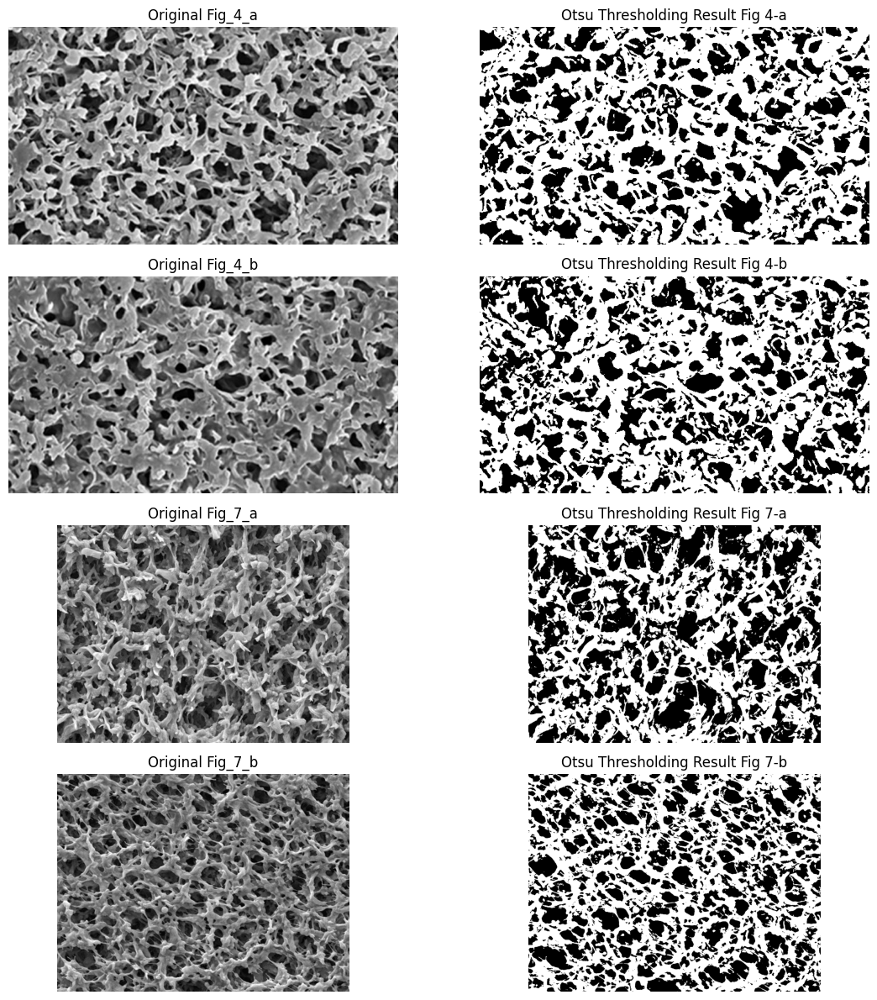

Otsu's threshold value of Fig_4_a:  116.0
Otsu's threshold value of Fig_4_b:  115.0
Otsu's threshold value of Fig_7_a:  116.0
Otsu's threshold value of Fig_7_b:  100.0


In [3]:
# Black is pores with a value of 0, white is solid with a value of 255
# Image threshold processing and display
Fig_4_a = cv2.imread('./Fig 4-a.jpg', cv2.IMREAD_GRAYSCALE)
Fig_4_b = cv2.imread('./Fig 4-b.jpg', cv2.IMREAD_GRAYSCALE)
Fig_7_a = cv2.imread('./Fig 7-a.jpg', cv2.IMREAD_GRAYSCALE)
Fig_7_b = cv2.imread('./Fig 7-b.jpg', cv2.IMREAD_GRAYSCALE)

otsu_threshold_4a, Fig_4_a_bi = cv2.threshold(
    Fig_4_a, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
)
otsu_threshold_4b, Fig_4_b_bi = cv2.threshold(
    Fig_4_b, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
)

otsu_threshold_7a, Fig_7_a_bi = cv2.threshold(
    Fig_7_a, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
)

otsu_threshold_7b, Fig_7_b_bi = cv2.threshold(
    Fig_7_b, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
)


plt.figure(figsize=(12, 12))

# Display the original Fig_4_a and its Otsu thresholding result
plt.subplot(4, 2, 1)
plt.title('Original Fig_4_a')
plt.imshow(Fig_4_a, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 2)
plt.title('Otsu Thresholding Result Fig 4-a')
plt.imshow(Fig_4_a_bi, cmap='gray')
plt.axis('off')

# Display the original Fig_4_b and its Otsu thresholding result
plt.subplot(4, 2, 3)
plt.title('Original Fig_4_b')
plt.imshow(Fig_4_b, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 4)
plt.title('Otsu Thresholding Result Fig 4-b')
plt.imshow(Fig_4_b_bi, cmap='gray')
plt.axis('off')

# Display the original Fig_7_a and its Otsu thresholding result
plt.subplot(4, 2, 5)
plt.title('Original Fig_7_a')
plt.imshow(Fig_7_a, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 6)
plt.title('Otsu Thresholding Result Fig 7-a')
plt.imshow(Fig_7_a_bi, cmap='gray')
plt.axis('off')

# Display the original Fig_7_b and its Otsu thresholding result
plt.subplot(4, 2, 7)
plt.title('Original Fig_7_b')
plt.imshow(Fig_7_b, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 8)
plt.title('Otsu Thresholding Result Fig 7-b')
plt.imshow(Fig_7_b_bi, cmap='gray')
plt.axis('off')

# Adjust layout to avoid overlap and show the plots
plt.tight_layout()
plt.show()

# Print the optimal threshold values computed by Otsu's method
print("Otsu's threshold value of Fig_4_a: ", otsu_threshold_4a)
print("Otsu's threshold value of Fig_4_b: ", otsu_threshold_4b)
print("Otsu's threshold value of Fig_7_a: ", otsu_threshold_7a)
print("Otsu's threshold value of Fig_7_b: ", otsu_threshold_7b)


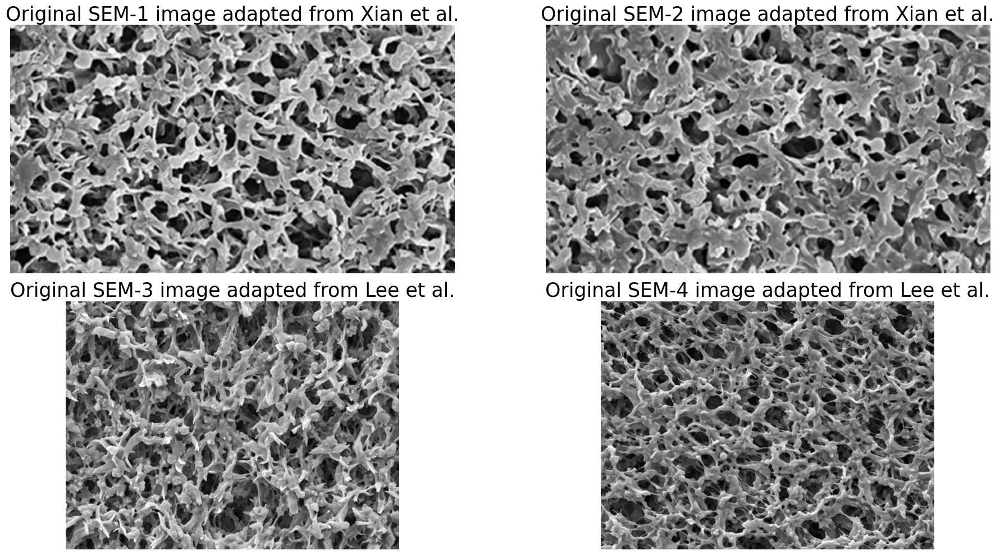

In [4]:
# Display all original SEM images
import matplotlib.pyplot as plt
import cv2

# Create a figure object and subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 10))  # 2 rows and 2 columns of subplots

# Display each image and add a title
axs[0, 0].imshow(Fig_4_a, cmap='gray')
axs[0, 0].set_title('Original SEM-1 image adapted from Xian et al.', fontsize=25)
axs[0, 0].axis('off')  # Hide the axis

axs[0, 1].imshow(Fig_4_b, cmap='gray')
axs[0, 1].set_title('Original SEM-2 image adapted from Xian et al.', fontsize=25)
axs[0, 1].axis('off')  

axs[1, 0].imshow(Fig_7_a, cmap='gray')
axs[1, 0].set_title('Original SEM-3 image adapted from Lee et al.', fontsize=25)
axs[1, 0].axis('off')  

axs[1, 1].imshow(Fig_7_b, cmap='gray')
axs[1, 1].set_title('Original SEM-4 image adapted from Lee et al.', fontsize=25)
axs[1, 1].axis('off')  

# Adjust layout to avoid overlap between titles and images
plt.tight_layout()

# Display the images
plt.show()


The current state does not involve mapping grey values. Later, grey values in the range of 0-255 need to be mapped to the range of 0-1 to achieve the same grey value distribution as in the synthetic data experiments, where black pores are represented by 0 and white solids by 1.

In [5]:
# Black is pores with a value of 0, white is solid with a value of 255
print("Fig_4_a_bi:",Fig_4_a_bi)
print("Fig_4_b_bi:",Fig_4_b_bi)
print("Fig_7_a_bi:",Fig_7_a_bi)
print("Fig_7_b_bi:",Fig_7_b_bi)

Fig_4_a_bi: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [  0   0 255 ...   0   0   0]
 [  0   0 255 ...   0   0 255]
 [  0   0   0 ... 255 255 255]]
Fig_4_b_bi: [[  0   0   0 ... 255 255 255]
 [  0   0   0 ... 255 255 255]
 [  0   0   0 ... 255 255 255]
 ...
 [  0   0   0 ...   0   0 255]
 [  0   0   0 ...   0   0   0]
 [255   0 255 ...   0   0   0]]
Fig_7_a_bi: [[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [255 255 255 ...   0   0   0]
 [255 255 255 ...   0   0   0]
 [255 255 255 ...   0   0   0]]
Fig_7_b_bi: [[  0   0   0 ... 255   0   0]
 [  0   0   0 ... 255 255   0]
 [  0   0   0 ... 255 255   0]
 ...
 [255 255 255 ... 255   0   0]
 [255 255 255 ... 255 255   0]
 [255 255 255 ... 255 255 255]]


In [6]:
# After grayscale mapping, black is pores with a value of 0, and white is solid with a value of 1
Fig_4_a_bi = (Fig_4_a_bi / 255).astype(np.uint8)
Fig_4_b_bi = (Fig_4_b_bi / 255).astype(np.uint8)
Fig_7_a_bi = (Fig_7_a_bi / 255).astype(np.uint8)
Fig_7_b_bi = (Fig_7_b_bi / 255).astype(np.uint8)
print("Fig_4_a_bi: ",Fig_4_a_bi)
print("Fig_4_b_bi: ",Fig_4_b_bi)
print("Fig_7_a_bi:",Fig_7_a_bi)
print("Fig_7_b_bi:",Fig_7_b_bi)

Fig_4_a_bi:  [[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [0 0 1 ... 0 0 0]
 [0 0 1 ... 0 0 1]
 [0 0 0 ... 1 1 1]]
Fig_4_b_bi:  [[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]
 [1 0 1 ... 0 0 0]]
Fig_7_a_bi: [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]
Fig_7_b_bi: [[0 0 0 ... 1 0 0]
 [0 0 0 ... 1 1 0]
 [0 0 0 ... 1 1 0]
 ...
 [1 1 1 ... 1 0 0]
 [1 1 1 ... 1 1 0]
 [1 1 1 ... 1 1 1]]


# (Optional)Visualizing the target slice

In [14]:
# Increase the dimension of Fig_4_b
depth = 50

# First, transpose the 2D image
Fig_4_b_bi_T = Fig_4_b_bi.T  # Transpose the image

# Then, stack along the third dimension to create a 3D array
Fig_4_b_bi_3d = np.stack([Fig_4_b_bi_T] * depth, axis=2)

# Output the shape of the 3D array
print(Fig_4_b_bi_3d.shape)


(1348, 1004, 50)


In [15]:
# Visualization of Fig_4_b in 3D
from mayavi import mlab
import numpy as np
from traitsui.api import Editor

Editor._ui_toolkit = 'qt'  

# Define the range of interest for the x, y, and z coordinates
x_min, x_max = 0, 300
y_min, y_max = 0, 300
z_min, z_max = 0, 50

# Create a smaller chunk of b_structure to avoid memory issues and potential crashes
b_structure_chunk = Fig_4_b_bi_3d[x_min:x_max, y_min:y_max, z_min:z_max]

# Use Mayavi for volume visualization
mlab.figure(size=(800, 800))
mlab.pipeline.volume(mlab.pipeline.scalar_field(b_structure_chunk), vmin=0.1, vmax=1)


# Show the visualization
mlab.show()


# 1.3 Image processing（Denoising）

Since the SEM images capture the surface of a porous polymer membrane and are not cross-sectional views, there is still significant noise present even after converting to a binary image using Otsu's method. Therefore, noise reduction is necessary. This noise reduction process involves removing white noise in black backgrounds and black noise in white backgrounds.

In [14]:
def remove_noise(image):
    # Create different-sized structuring elements based on the input image size
    width, height = height_weight(image)
    if width < 1000:
        # Define structuring elements for smaller images
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))  # Kernel for closing operation
        remove_white_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))  # Kernel for opening operation
    else:
        # Define structuring elements for larger images
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        remove_white_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    
    # Use morphological opening to remove small white spots in black pores
    open_image = cv2.morphologyEx(image, cv2.MORPH_OPEN, remove_white_kernel)
    
    # Use morphological closing on the result of opening to remove black pores in white solids
    closed_image = cv2.morphologyEx(open_image, cv2.MORPH_CLOSE, kernel)
    
    return closed_image


In [8]:
# Returns the width and height of the image
def height_weight(img):
    height, width = img.shape[:2]
    return width, height

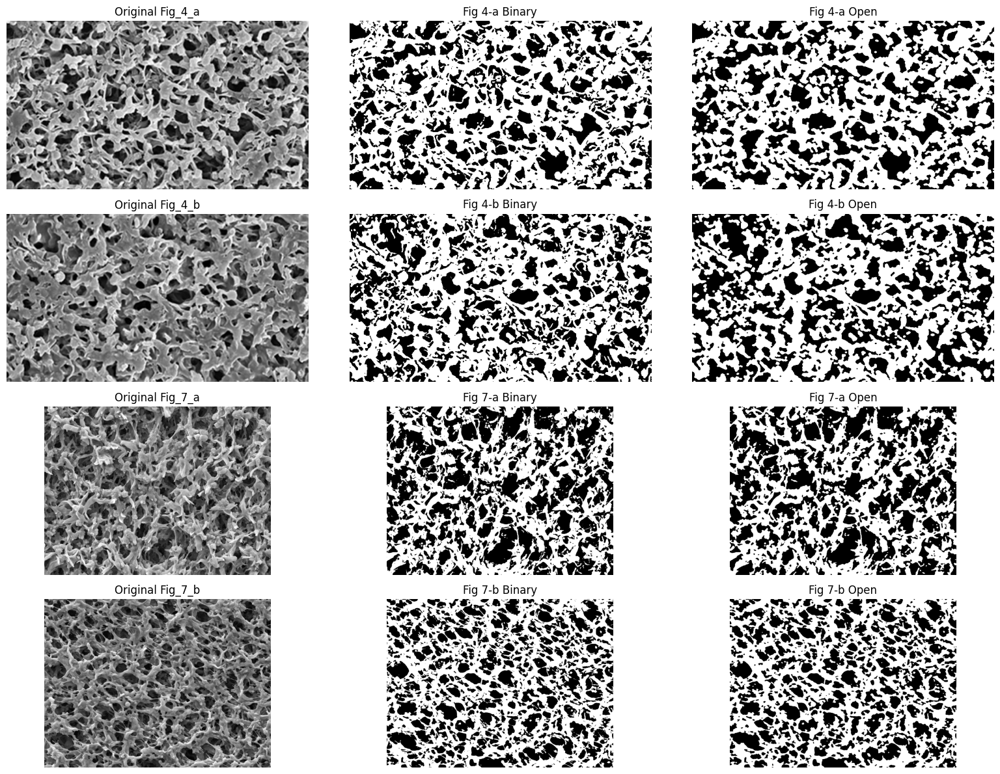

Fig_4_a_open [[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [0 0 1 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Fig_4_b_open [[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Fig_7_a_open [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]
Fig_7_b_open [[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]


In [15]:
# Show the denoised image
Fig_4_a_open = remove_noise(Fig_4_a_bi)
Fig_4_b_open = remove_noise(Fig_4_b_bi)
Fig_7_a_open = remove_noise(Fig_7_a_bi)
Fig_7_b_open = remove_noise(Fig_7_b_bi)

# Use matplotlib to create subplots to display all images
plt.figure(figsize=(16, 12))

# image Fig_4_a
plt.subplot(4, 3, 1)
plt.title('Original Fig_4_a')
plt.imshow(Fig_4_a, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 2)
plt.title('Fig 4-a Binary')
plt.imshow(Fig_4_a_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 3)
plt.title('Fig 4-a Open')
plt.imshow(Fig_4_a_open, cmap='gray')
plt.axis('off')

# image Fig_4_b
plt.subplot(4, 3, 4)
plt.title('Original Fig_4_b')
plt.imshow(Fig_4_b, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 5)
plt.title('Fig 4-b Binary')
plt.imshow(Fig_4_b_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 6)
plt.title('Fig 4-b Open')
plt.imshow(Fig_4_b_open, cmap='gray')
plt.axis('off')

# image Fig_7_a
plt.subplot(4, 3, 7)
plt.title('Original Fig_7_a')
plt.imshow(Fig_7_a, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 8)
plt.title('Fig 7-a Binary')
plt.imshow(Fig_7_a_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 9)
plt.title('Fig 7-a Open')
plt.imshow(Fig_7_a_open, cmap='gray')
plt.axis('off')

# image Fig_7_b
plt.subplot(4, 3, 10)
plt.title('Original Fig_7_b')
plt.imshow(Fig_7_b, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 11)
plt.title('Fig 7-b Binary')
plt.imshow(Fig_7_b_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 3, 12)
plt.title('Fig 7-b Open')
plt.imshow(Fig_7_b_open, cmap='gray')
plt.axis('off')

# Adjust sub-image spacing
plt.tight_layout()

# Display all subgraphs
plt.show()

print("Fig_4_a_open",Fig_4_a_open)
print("Fig_4_b_open",Fig_4_b_open)
print("Fig_7_a_open",Fig_7_a_open)
print("Fig_7_b_open",Fig_7_b_open)

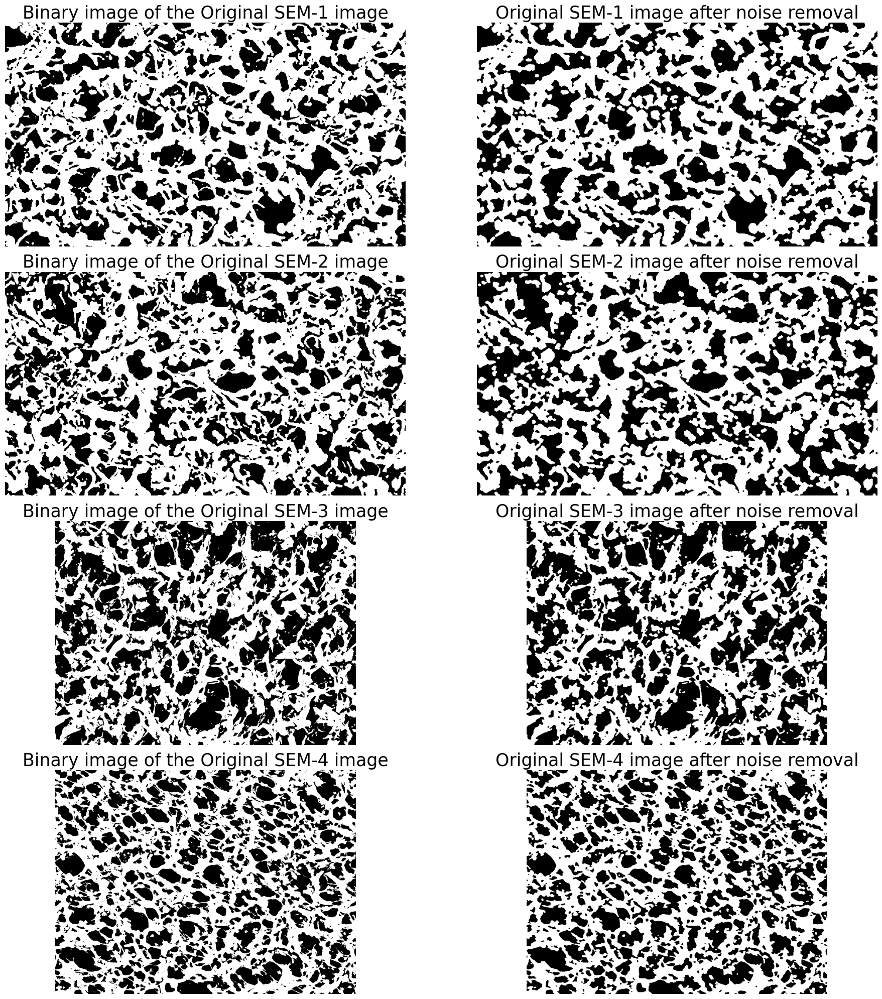

In [16]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 20))  

# Fig_4_a
plt.subplot(4, 2, 1)
plt.title('Binary image of the Original SEM-1 image', fontsize=25)
plt.imshow(Fig_4_a_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 2)
plt.title('Original SEM-1 image after noise removal', fontsize=25)
plt.imshow(Fig_4_a_open, cmap='gray')
plt.axis('off')

# Fig_4_b
plt.subplot(4, 2, 3)
plt.title('Binary image of the Original SEM-2 image', fontsize=25)
plt.imshow(Fig_4_b_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 4)
plt.title('Original SEM-2 image after noise removal', fontsize=25)
plt.imshow(Fig_4_b_open, cmap='gray')
plt.axis('off')

# Fig_7_a
plt.subplot(4, 2, 5)
plt.title('Binary image of the Original SEM-3 image', fontsize=25)
plt.imshow(Fig_7_a_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 6)
plt.title('Original SEM-3 image after noise removal', fontsize=25)
plt.imshow(Fig_7_a_open, cmap='gray')
plt.axis('off')

# Fig_7_b
plt.subplot(4, 2, 7)
plt.title('Binary image of the Original SEM-4 image', fontsize=25)
plt.imshow(Fig_7_b_bi, cmap='gray')
plt.axis('off')

plt.subplot(4, 2, 8)
plt.title('Original SEM-4 image after noise removal', fontsize=25)
plt.imshow(Fig_7_b_open, cmap='gray')
plt.axis('off')

plt.tight_layout()

plt.show()


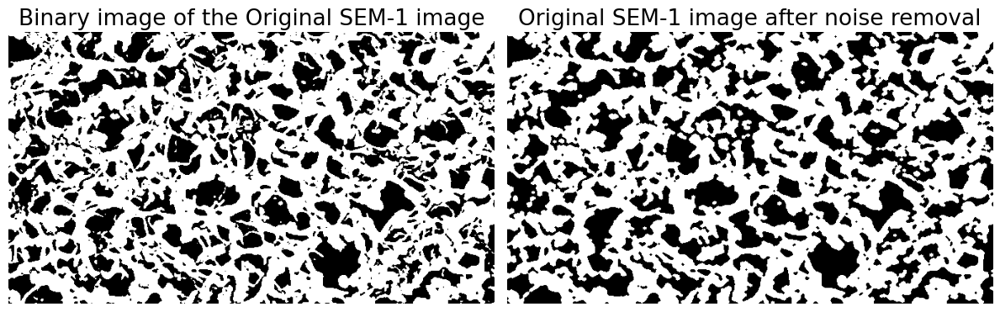

In [17]:
# Only the comparison pictures of SEM3 before and after denoising are shown
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))  

# Binary image of the original SEM-3 image
plt.subplot(1, 2, 1)
plt.title('Binary image of the Original SEM-1 image', fontsize=19)
plt.imshow(Fig_4_a_bi, cmap='gray')
plt.axis('off')

# Processed SEM-3 image
plt.subplot(1, 2, 2)
plt.title('Original SEM-1 image after noise removal', fontsize=19)
plt.imshow(Fig_4_a_open, cmap='gray')
plt.axis('off')

plt.tight_layout()

plt.show()


In [10]:
target_slices = []
target_slices.append(Fig_4_a_open)
target_slices.append(Fig_4_b_open)
target_slices.append(Fig_7_a_open)
target_slices.append(Fig_7_b_open)
target_slices

[array([[1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        ...,
        [0, 0, 1, ..., 0, 0, 0],
        [0, 0, 1, ..., 0, 0, 1],
        [0, 0, 0, ..., 1, 1, 1]], dtype=uint8),
 array([[0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [0, 0, 0, ..., 0, 0, 1],
        [0, 0, 0, ..., 0, 0, 0],
        [1, 0, 1, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [1, 1, 1, ..., 0, 0, 0],
        [1, 1, 1, ..., 0, 0, 0],
        [1, 1, 1, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        [0, 0, 0, ..., 1, 1, 1],
        ...,
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1]], dtype=uint8)]

In [11]:
Fig_4_a_wid, Fig_4_a_height = height_weight(Fig_4_a)
print(f"Fig 4-a Width: {Fig_4_a_wid}, Height: {Fig_4_a_height}")

Fig_4_b_wid, Fig_4_b_height = height_weight(Fig_4_b)
print(f"Fig 4-b Width: {Fig_4_b_wid}, Height: {Fig_4_b_height}")

Fig_7_a_wid, Fig_7_a_height = height_weight(Fig_7_a)
print(f"Fig 7-a Width: {Fig_7_a_wid}, Height: {Fig_7_a_height}")

Fig_7_b_wid, Fig_7_b_height = height_weight(Fig_7_b)
print(f"Fig 7-b Width: {Fig_7_b_wid}, Height: {Fig_7_b_height}")


Fig 4-a Width: 680, Height: 380
Fig 4-b Width: 680, Height: 380
Fig 7-a Width: 1348, Height: 1004
Fig 7-b Width: 1348, Height: 1004


# 1.4 Generate function

Custom statistical generation methods for generating 3D structures of porous polymeric membranes and their 2D slices based on different sigma and quantile combinations

In [19]:
import numpy as np
from scipy.ndimage import gaussian_filter as gaussian
from bayes_opt import BayesianOptimization
from sklearn.metrics import mean_squared_error
from skimage.filters import gaussian  # Import Gaussian filter function from skimage.filters module
import matplotlib.pyplot as plt  # Import matplotlib.pyplot for visualization

# Function to generate a synthetic 3D structure
def generate_synthetic_3d_structure(sigma, quantile, shape):
    random_field = np.random.rand(*shape)  # Generate a random 3D array with the given shape
    filtered_field = gaussian(random_field, sigma=sigma, mode='reflect', preserve_range=True)  
    # Apply Gaussian filter to smooth the random field
    threshold = np.quantile(filtered_field, quantile)  # Compute the quantile threshold of the filtered field
    binary_field = (filtered_field > threshold).astype(int)  
    # Binarize the field based on the threshold to generate a synthetic 3D structure
    # 0 represents void space, 1 represents solid space
    return binary_field  # Return the generated 3D binary structure

# Function to extract 2D slices from the 3D binary structure
def extract_2d_slices(binary_field):
    slices = []
    for i in range(binary_field.shape[2]):
        slices.append(binary_field[:, :, i])
    return slices


# 2. Get the distance transform histogram

## 2.1 Get the distance transform image of the input image¶

In [13]:
#Confirm whether it is a binary image with only 0 and 1
def is_binary(image):
    unique_value = np.unique(image)
    return np.array_equal(unique_value, [0, 1])

In [14]:
# Function to distance transform image
def transform(img):
    # Check if the image is in color (3 channels) and convert to grayscale if needed
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
    # Ensure the image is in 'uint8' format
    if img.dtype != 'uint8':
        img = img.astype('uint8')
        
    # Apply thresholding to convert image to binary
#     _, img_binary = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)#1是白色，0是黑色
    if is_binary(img): 
        # Apply distance transform to the binary image
#         transform_img = cv2.distanceTransform(img_binary, cv2.DIST_L2, 3)
        transform_img = cv2.distanceTransform(img, cv2.DIST_L2, 3)
        _, img_binary = cv2.threshold(img, 0, 1, cv2.THRESH_BINARY | cv2.THRESH_OTSU)#1是白色，0是黑色
    else:
        print("The input image is not binarized.")
        _, img_binary = cv2.threshold(img, 0, 1, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
        transform_img = cv2.distanceTransform(img_binary, cv2.DIST_L2, 3)
    return transform_img, img_binary

## 2.2 Get the histogram of transform image with same bins_edge

All bins of the distance transform histogram are generated based on the target data. This is different from the synthetic data. Since each target data contains only one slice, there is only one bin.

In [15]:
#In order to unify the Bin_edges of the distance transform histogram, all synthetic data are used to calculate Bin_edges
# Only one slice
def calculate_bin_edge(target_slice, num_bin):
    transform_img, _ = transform(target_slice)
    
    # Combine all transform images values into one large array
    min_val = np.min(transform_img)
    max_val = np.max(transform_img)

    # Generate bin edges based on the combined data array
    return np.linspace(min_val, max_val, num_bin + 1)

In [16]:
#function to get the histogram image used the calculated "bin_edges" to generate hisotgram of transform image
import cv2
import matplotlib.pyplot as plt
import numpy as np

def hist_transform(img, bin_edges):
    # Apply the transformation function to the image
    transform_img, img_binary = transform(img)
    
    # Calculate the histogram of the transformed image
    transform_hist_img, _ = np.histogram(transform_img, bins=bin_edges)
    
    return transform_img, transform_hist_img #return transform image and its histogram


## Difine function of comparing two histgram

In [17]:
# Function to calculate histogram similarity, the input are two histogram
def hist_similar(lh, rh):
    # Ensure both histograms have the same length, all of them are 50
    assert len(lh) == len(rh), "The lengths of both histograms must be the same"
    
    # Calculate the similarity between each corresponding bin and average the differences
    hist_similarity = sum(1 - (0 if l == r else float(abs(l - r)) / max(l, r)) for l, r in zip(lh, rh)) / len(lh)
    
    return hist_similarity

# 3. Bayesion

### 3.1 Data preperation

In [29]:
targets_info = []
target_names = ["Fig_4_a","Fig_4_b","Fig_7_a","Fig_7_b"]
for target_slice,name in zip (target_slices,target_names):
    bin_edges = calculate_bin_edge(target_slice, num_bin=50)
    targets_info.append({
        'slice': target_slice,
        'bin_edges': bin_edges,
        'slice_name':name
    })

In [30]:
print(targets_info)

[{'slice': array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 1, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 1],
       [0, 0, 0, ..., 1, 1, 1]], dtype=uint8), 'bin_edges': array([ 0.        ,  0.32863201,  0.65726402,  0.98589603,  1.31452805,
        1.64316006,  1.97179207,  2.30042408,  2.62905609,  2.9576881 ,
        3.28632011,  3.61495213,  3.94358414,  4.27221615,  4.60084816,
        4.92948017,  5.25811218,  5.58674419,  5.91537621,  6.24400822,
        6.57264023,  6.90127224,  7.22990425,  7.55853626,  7.88716827,
        8.21580029,  8.5444323 ,  8.87306431,  9.20169632,  9.53032833,
        9.85896034, 10.18759235, 10.51622437, 10.84485638, 11.17348839,
       11.5021204 , 11.83075241, 12.15938442, 12.48801643, 12.81664845,
       13.14528046, 13.47391247, 13.80254448, 14.13117649, 14.4598085 ,
       14.78844051, 15.11707253, 15.44570454, 15.77433655, 16.10296856,
       16.43160057]), 'slice_name': '

### 3.2 Bayesian Optimization Algorithm

Each time a 3D structure of a porous polymer membrane is generated, each slice must be compared to the target slice using their distance transform histogram to obtain an average score. Bayesian optimization will maximize this average score.

In [122]:
from bayes_opt import BayesianOptimization, UtilityFunction
import time

def objective_function(sigma, quantile, target_slice, target_bin_edges):
    wid, height = height_weight(target_slice)
    depth = 60
    shape=( height,wid, depth)
    generated_structure = generate_synthetic_3d_structure(sigma=sigma, quantile=quantile,shape=shape)
    generated_slices = extract_2d_slices(generated_structure)
    
    target_transform_img, target_transform_hist = hist_transform(target_slice, target_bin_edges)
    similarity_total = 0
    for generated_slice in generated_slices:
        generated_transform_img, generated_transform_hist = hist_transform(generated_slice, target_bin_edges)
        similarity_total += hist_similar(target_transform_hist, generated_transform_hist)

    average_similarity = similarity_total /len(generated_slices)
    return average_similarity


In [123]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import time

def run_bayesian_optimization(target_slice, target_bin_edges, pbounds, acq_function, init_points=40, n_iter=60):
    # Create an instance of UtilityFunction with the desired acquisition function
    utility_function = UtilityFunction(kind=acq_function)
    
    # Define the objective function
    def objective_function_wrapper(sigma, quantile):
        return objective_function(sigma, quantile, target_slice, target_bin_edges)
    
    # Initialize BayesianOptimization with the acquisition function
    optimizer = BayesianOptimization(
        f=objective_function_wrapper,
        pbounds=pbounds,
        verbose=2,
        random_state=1
    )

    # Start time measurement
    start_time = time.time()
    
    # Run the optimization
    optimizer.maximize(
        init_points=init_points,
        n_iter=n_iter
    )
    
    # End time measurement
    end_time = time.time()
    
    #save results
    optimal_sigma = optimizer.max['params']['sigma']
    optimal_quantile = optimizer.max['params']['quantile']
    execution_time = end_time - start_time
    
    # Print results
    print(f"Acquisition Function: {acq_function}")
    print(f"Optimal sigma: {optimizer.max['params']['sigma']}")
    print(f"Optimal quantile: {optimizer.max['params']['quantile']}")
    print(f"Time taken: {end_time - start_time} seconds")
    print("")
    
    return optimal_sigma,optimal_quantile,execution_time



In [124]:
results_acq = []

# Define the parameter bounds
pbounds = {
    'sigma': (0.1, 9.0),
    'quantile': (0.1, 0.9)
}

# List of acquisition functions to test
acq_functions = ['ucb', 'ei', 'poi']

num = 0
# Run optimization for each acquisition function
for i,target_info in enumerate(targets_info):
    target_slice = target_info['slice']
    target_bin_edges = target_info['bin_edges']
    target_name = target_info['slice_name']
    num+=1

    for acq_function in acq_functions:
        print(f"Running optimization for Slices: {i} with Acquisition Function: {acq_function}")
       
        optimal_sigma,optimal_quantile,execution_time = run_bayesian_optimization(target_slice, target_bin_edges, pbounds, acq_function)
        results_acq.append({
            'ID':num,
            'Name':target_name,
            'Target_slice':target_slice,
            'Acquisition Function':acq_function,
            'Optimal_sigma':optimal_sigma,
            'Optimal_quantile':optimal_quantile,
            'Time':execution_time
        })
        

Running optimization for Slices: 0 with Acquisition Function: ucb
|   iter    |  target   | quantile  |   sigma   |
-------------------------------------------------
| 1         | 0.4888    | 0.4336    | 6.511     |
| 2         | 0.4198    | 0.1001    | 2.791     |
| 3         | 0.1983    | 0.2174    | 0.9218    |
| 4         | 0.5925    | 0.249     | 3.175     |
| 5         | 0.5743    | 0.4174    | 4.895     |
| 6         | 0.4994    | 0.4354    | 6.198     |
| 7         | 0.417     | 0.2636    | 7.915     |
| 8         | 0.3943    | 0.1219    | 6.067     |
| 9         | 0.573     | 0.4338    | 5.072     |
| 10        | 0.4478    | 0.2123    | 1.863     |
| 11        | 0.4821    | 0.7406    | 8.718     |
| 12        | 0.4723    | 0.3507    | 6.262     |
| 13        | 0.484     | 0.8011    | 8.062     |
| 14        | 0.155     | 0.168     | 0.4476    |
| 15        | 0.4111    | 0.2359    | 7.915     |
| 16        | 0.4434    | 0.1787    | 3.848     |
| 17        | 0.1785    | 0.8663  

| 91        | 0.7941    | 0.3495    | 3.146     |
| 92        | 0.8128    | 0.3271    | 3.145     |
| 93        | 0.8126    | 0.3374    | 3.128     |
| 94        | 0.3978    | 0.1599    | 7.002     |
| 95        | 0.3749    | 0.1252    | 8.725     |
| 96        | 0.4891    | 0.485     | 6.936     |
| 97        | 0.8165    | 0.3181    | 3.126     |
| 98        | 0.7689    | 0.3056    | 3.144     |
| 99        | 0.119     | 0.6759    | 0.4027    |
| 100       | 0.6976    | 0.2047    | 2.471     |
Acquisition Function: ucb
Optimal sigma: 3.1609199464159587
Optimal quantile: 0.33746059511095516
Time taken: 195.3162281513214 seconds

Running optimization for Slices: 0 with Acquisition Function: ei
|   iter    |  target   | quantile  |   sigma   |
-------------------------------------------------
| 1         | 0.4836    | 0.4336    | 6.511     |
| 2         | 0.4206    | 0.1001    | 2.791     |
| 3         | 0.1983    | 0.2174    | 0.9218    |
| 4         | 0.5857    | 0.249     | 3.175     

| 79        | 0.7667    | 0.2648    | 2.593     |
| 80        | 0.3066    | 0.1358    | 1.178     |
| 81        | 0.8315    | 0.3764    | 3.452     |
| 82        | 0.7839    | 0.3504    | 3.469     |
| 83        | 0.308     | 0.5589    | 2.868     |
| 84        | 0.831     | 0.3856    | 3.518     |
| 85        | 0.7722    | 0.3539    | 3.51      |
| 86        | 0.7562    | 0.4156    | 3.536     |
| 87        | 0.8133    | 0.3513    | 3.427     |
| 88        | 0.1764    | 0.4052    | 0.911     |
| 89        | 0.6679    | 0.3172    | 3.44      |
| 90        | 0.8027    | 0.3873    | 3.415     |
| 91        | 0.794     | 0.3732    | 3.553     |
| 92        | 0.6965    | 0.3328    | 3.551     |
| 93        | 0.8179    | 0.3581    | 3.387     |
| 94        | 0.3986    | 0.1599    | 7.002     |
| 95        | 0.3727    | 0.1252    | 8.725     |
| 96        | 0.4886    | 0.485     | 6.936     |
| 97        | 0.7621    | 0.393     | 3.372     |
| 98        | 0.452     | 0.4364    | 7.869     |


| 67        | 0.8035    | 0.3264    | 3.222     |
| 68        | 0.7236    | 0.3003    | 3.242     |
| 69        | 0.7768    | 0.2238    | 2.446     |
| 70        | 0.8219    | 0.3657    | 3.293     |
| 71        | 0.7261    | 0.3972    | 3.304     |
| 72        | 0.8185    | 0.3633    | 3.326     |
| 73        | 0.7597    | 0.3848    | 3.35      |
| 74        | 0.1466    | 0.5857    | 0.7302    |
| 75        | 0.7502    | 0.4189    | 3.494     |
| 76        | 0.7682    | 0.2243    | 2.48      |
| 77        | 0.6705    | 0.1917    | 2.462     |
| 78        | 0.7963    | 0.3387    | 3.353     |
| 79        | 0.8231    | 0.3593    | 3.386     |
| 80        | 0.307     | 0.1358    | 1.178     |
| 81        | 0.7272    | 0.3235    | 3.393     |
| 82        | 0.8088    | 0.3773    | 3.425     |
| 83        | 0.3063    | 0.5589    | 2.868     |
| 84        | 0.7395    | 0.4136    | 3.448     |
| 85        | 0.7511    | 0.4036    | 3.397     |
| 86        | 0.8327    | 0.3749    | 3.474     |


| 55        | 0.6992    | 0.5527    | 4.61      |
| 56        | 0.681     | 0.5046    | 4.556     |
| 57        | 0.6841    | 0.5421    | 4.688     |
| 58        | 0.6647    | 0.5201    | 4.772     |
| 59        | 0.6239    | 0.5957    | 4.792     |
| 60        | 0.4081    | 0.4338    | 6.511     |
| 61        | 0.4479    | 0.2593    | 2.15      |
| 62        | 0.6729    | 0.5425    | 4.869     |
| 63        | 0.6348    | 0.5839    | 4.953     |
| 64        | 0.5619    | 0.6347    | 4.886     |
| 65        | 0.6151    | 0.5917    | 5.066     |
| 66        | 0.4976    | 0.6817    | 5.026     |
| 67        | 0.562     | 0.5097    | 4.985     |
| 68        | 0.6155    | 0.562     | 5.181     |
| 69        | 0.4845    | 0.4685    | 5.254     |
| 70        | 0.568     | 0.6598    | 5.167     |
| 71        | 0.6171    | 0.6068    | 5.29      |
| 72        | 0.5891    | 0.5647    | 5.407     |
| 73        | 0.4604    | 0.4477    | 5.474     |
| 74        | 0.6006    | 0.6377    | 5.516     |


| 43        | 0.3941    | 0.1415    | 2.506     |
| 44        | 0.5299    | 0.3349    | 2.573     |
| 45        | 0.5587    | 0.45      | 4.579     |
| 46        | 0.5584    | 0.5889    | 4.433     |
| 47        | 0.5105    | 0.3985    | 4.373     |
| 48        | 0.294     | 0.855     | 6.308     |
| 49        | 0.2029    | 0.7763    | 4.277     |
| 50        | 0.6531    | 0.1838    | 2.122     |
| 51        | 0.7261    | 0.3521    | 3.231     |
| 52        | 0.7262    | 0.4014    | 3.345     |
| 53        | 0.4924    | 0.4707    | 3.24      |
| 54        | 0.5971    | 0.4521    | 4.574     |
| 55        | 0.6263    | 0.4858    | 4.498     |
| 56        | 0.7092    | 0.3483    | 3.3       |
| 57        | 0.6969    | 0.3981    | 3.281     |
| 58        | 0.6818    | 0.5343    | 4.56      |
| 59        | 0.6688    | 0.3485    | 3.403     |
| 60        | 0.4339    | 0.499     | 6.522     |
| 61        | 0.6524    | 0.4415    | 3.427     |
| 62        | 0.4055    | 0.1075    | 2.064     |


| 31        | 0.3586    | 0.1819    | 3.785     |
| 32        | 0.2838    | 0.6555    | 3.786     |
| 33        | 0.3337    | 0.14      | 4.869     |
| 34        | 0.5376    | 0.631     | 4.683     |
| 35        | 0.2094    | 0.8557    | 5.32      |
| 36        | 0.1076    | 0.8227    | 1.324     |
| 37        | 0.3412    | 0.2114    | 7.286     |
| 38        | 0.1978    | 0.4181    | 1.572     |
| 39        | 0.1282    | 0.842     | 3.195     |
| 40        | 0.5261    | 0.7006    | 6.561     |
| 41        | 0.5021    | 0.1594    | 2.274     |
| 42        | 0.3056    | 0.4299    | 2.349     |
| 43        | 0.3644    | 0.1224    | 2.486     |
| 44        | 0.5246    | 0.33      | 2.572     |
| 45        | 0.5951    | 0.4779    | 4.592     |
| 46        | 0.5846    | 0.6049    | 4.468     |
| 47        | 0.5445    | 0.4208    | 4.396     |
| 48        | 0.3354    | 0.8265    | 6.341     |
| 49        | 0.4209    | 0.6189    | 4.251     |
| 50        | 0.6576    | 0.1838    | 2.122     |


| 19        | 0.3662    | 0.6492    | 7.528     |
| 20        | 0.3197    | 0.1146    | 6.776     |
| 21        | 0.07533   | 0.8911    | 6.759     |
| 22        | 0.5223    | 0.3244    | 7.125     |
| 23        | 0.5604    | 0.1826    | 4.086     |
| 24        | 0.07675   | 0.8269    | 2.713     |
| 25        | 0.06549   | 0.3302    | 1.257     |
| 26        | 0.3222    | 0.1155    | 6.142     |
| 27        | 0.1511    | 0.2693    | 2.463     |
| 28        | 0.03573   | 0.4933    | 0.5749    |
| 29        | 0.0604    | 0.5593    | 1.406     |
| 30        | 0.3255    | 0.5714    | 6.328     |
| 31        | 0.4625    | 0.1819    | 3.785     |
| 32        | 0.143     | 0.6555    | 3.786     |
| 33        | 0.3946    | 0.14      | 4.869     |
| 34        | 0.1909    | 0.631     | 4.683     |
| 35        | 0.09189   | 0.8557    | 5.32      |
| 36        | 0.03785   | 0.8227    | 1.324     |
| 37        | 0.3673    | 0.2114    | 7.286     |
| 38        | 0.07587   | 0.4181    | 1.572     |


| 7         | 0.3949    | 0.2636    | 7.915     |
| 8         | 0.327     | 0.1219    | 6.067     |
| 9         | 0.3118    | 0.4338    | 5.072     |
| 10        | 0.1198    | 0.2123    | 1.863     |
| 11        | 0.228     | 0.7406    | 8.718     |
| 12        | 0.7458    | 0.3507    | 6.262     |
| 13        | 0.1525    | 0.8011    | 8.062     |
| 14        | 0.03553   | 0.168     | 0.4476    |
| 15        | 0.3734    | 0.2359    | 7.915     |
| 16        | 0.5117    | 0.1787    | 3.848     |
| 17        | 0.08306   | 0.8663    | 4.845     |
| 18        | 0.1056    | 0.6535    | 2.908     |
| 19        | 0.3226    | 0.6492    | 7.528     |
| 20        | 0.3213    | 0.1146    | 6.776     |
| 21        | 0.07517   | 0.8911    | 6.759     |
| 22        | 0.5602    | 0.3244    | 7.125     |
| 23        | 0.5829    | 0.1826    | 4.086     |
| 24        | 0.07653   | 0.8269    | 2.713     |
| 25        | 0.06551   | 0.3302    | 1.257     |
| 26        | 0.3237    | 0.1155    | 6.142     |


| 99        | 0.01815   | 0.6759    | 0.4027    |
| 100       | 0.7171    | 0.423     | 7.612     |
Acquisition Function: ei
Optimal sigma: 6.983441302073211
Optimal quantile: 0.3987814086281597
Time taken: 1141.9315490722656 seconds

Running optimization for Slices: 2 with Acquisition Function: poi
|   iter    |  target   | quantile  |   sigma   |
-------------------------------------------------
| 1         | 0.5486    | 0.4336    | 6.511     |
| 2         | 0.4249    | 0.1001    | 2.791     |
| 3         | 0.05688   | 0.2174    | 0.9218    |
| 4         | 0.2326    | 0.249     | 3.175     |
| 5         | 0.3105    | 0.4174    | 4.895     |
| 6         | 0.5064    | 0.4354    | 6.198     |
| 7         | 0.3969    | 0.2636    | 7.915     |
| 8         | 0.3266    | 0.1219    | 6.067     |
| 9         | 0.3137    | 0.4338    | 5.072     |
| 10        | 0.1201    | 0.2123    | 1.863     |
| 11        | 0.2601    | 0.7406    | 8.718     |
| 12        | 0.6899    | 0.3507    | 6.262     |

| 87        | 0.7931    | 0.4041    | 6.981     |
| 88        | 0.05043   | 0.4052    | 0.911     |
| 89        | 0.3524    | 0.1406    | 5.41      |
| 90        | 0.7305    | 0.3612    | 6.25      |
| 91        | 0.7611    | 0.3909    | 6.854     |
| 92        | 0.1658    | 0.2995    | 2.775     |
| 93        | 0.3315    | 0.621     | 7.34      |
| 94        | 0.341     | 0.1599    | 7.002     |
| 95        | 0.3194    | 0.1252    | 8.725     |
| 96        | 0.5483    | 0.485     | 6.936     |
| 97        | 0.1936    | 0.5659    | 4.354     |
| 98        | 0.7064    | 0.3685    | 6.256     |
| 99        | 0.01815   | 0.6759    | 0.4027    |
| 100       | 0.7628    | 0.3996    | 6.856     |
Acquisition Function: poi
Optimal sigma: 6.986274137753409
Optimal quantile: 0.39715973811045624
Time taken: 1146.5177400112152 seconds

Running optimization for Slices: 3 with Acquisition Function: ucb
|   iter    |  target   | quantile  |   sigma   |
-----------------------------------------------

| 75        | 0.2101    | 0.4189    | 3.494     |
| 76        | 0.7892    | 0.3495    | 6.303     |
| 77        | 0.7786    | 0.3604    | 6.353     |
| 78        | 0.8258    | 0.4098    | 6.638     |
| 79        | 0.1075    | 0.7907    | 3.535     |
| 80        | 0.09814   | 0.1358    | 1.178     |
| 81        | 0.8031    | 0.3814    | 6.286     |
| 82        | 0.7176    | 0.3718    | 6.729     |
| 83        | 0.1279    | 0.5589    | 2.868     |
| 84        | 0.7663    | 0.4372    | 6.648     |
| 85        | 0.726     | 0.3727    | 6.767     |
| 86        | 0.3373    | 0.4957    | 5.342     |
| 87        | 0.675     | 0.4596    | 6.731     |
| 88        | 0.05448   | 0.4052    | 0.911     |
| 89        | 0.7995    | 0.379     | 6.386     |
| 90        | 0.7652    | 0.3735    | 6.628     |
| 91        | 0.8146    | 0.408     | 6.598     |
| 92        | 0.7156    | 0.4349    | 6.565     |
| 93        | 0.7607    | 0.3172    | 5.691     |
| 94        | 0.3518    | 0.1599    | 7.002     |


| 63        | 0.8144    | 0.422     | 6.708     |
| 64        | 0.6676    | 0.4507    | 6.517     |
| 65        | 0.6912    | 0.5774    | 8.768     |
| 66        | 0.8072    | 0.4019    | 6.71      |
| 67        | 0.7863    | 0.3911    | 6.729     |
| 68        | 0.7639    | 0.375     | 6.711     |
| 69        | 0.1965    | 0.2238    | 2.446     |
| 70        | 0.83      | 0.3953    | 6.564     |
| 71        | 0.8166    | 0.3885    | 6.59      |
| 72        | 0.814     | 0.4028    | 6.536     |
| 73        | 0.7316    | 0.3643    | 6.577     |
| 74        | 0.03564   | 0.5857    | 0.7302    |
| 75        | 0.2099    | 0.4189    | 3.494     |
| 76        | 0.7452    | 0.3471    | 6.296     |
| 77        | 0.799     | 0.3785    | 6.281     |
| 78        | 0.7854    | 0.388     | 6.252     |
| 79        | 0.7839    | 0.3751    | 6.319     |
| 80        | 0.09852   | 0.1358    | 1.178     |
| 81        | 0.7       | 0.4246    | 6.251     |
| 82        | 0.8122    | 0.4056    | 6.622     |


| 51        | 0.2993    | 0.1       | 9.0       |
| 52        | 0.6026    | 0.4827    | 6.628     |
| 53        | 0.6775    | 0.349     | 6.648     |
| 54        | 0.7569    | 0.4062    | 6.375     |
| 55        | 0.3062    | 0.1       | 8.422     |
| 56        | 0.01997   | 0.9       | 0.1       |
| 57        | 0.4445    | 0.469     | 5.792     |
| 58        | 0.0487    | 0.9       | 2.057     |
| 59        | 0.06272   | 0.9       | 5.878     |
| 60        | 0.7338    | 0.4337    | 6.511     |
| 61        | 0.5643    | 0.1866    | 3.785     |
| 62        | 0.658     | 0.3442    | 6.649     |
| 63        | 0.771     | 0.4345    | 6.704     |
| 64        | 0.7357    | 0.345     | 6.26      |
| 65        | 0.7081    | 0.5774    | 8.768     |
| 66        | 0.7183    | 0.4306    | 6.504     |
| 67        | 0.7848    | 0.4278    | 6.703     |
| 68        | 0.7623    | 0.3507    | 6.254     |
| 69        | 0.1952    | 0.2238    | 2.446     |
| 70        | 0.7846    | 0.3583    | 6.257     |


In [125]:
print(results_acq)

[{'ID': 1, 'Name': 'Fig_4_a', 'Target_slice': array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 1, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 1],
       [0, 0, 0, ..., 1, 1, 1]], dtype=uint8), 'Acquisition Function': 'ucb', 'Optimal_sigma': 3.1609199464159587, 'Optimal_quantile': 0.33746059511095516, 'Time': 195.3162281513214}, {'ID': 1, 'Name': 'Fig_4_a', 'Target_slice': array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 1, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 1],
       [0, 0, 0, ..., 1, 1, 1]], dtype=uint8), 'Acquisition Function': 'ei', 'Optimal_sigma': 3.452422948653123, 'Optimal_quantile': 0.37639966206270653, 'Time': 199.732914686203}, {'ID': 1, 'Name': 'Fig_4_a', 'Target_slice': array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 1, ..., 0, 0, 0],
       [0, 0, 1

In [126]:
import pandas as pd
result_df = pd.DataFrame(results_acq)
print(result_df)
result_df.to_csv('Real data-results.csv', index=False)

    ID     Name                                       Target_slice  \
0    1  Fig_4_a  [[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,...   
1    1  Fig_4_a  [[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,...   
2    1  Fig_4_a  [[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,...   
3    2  Fig_4_b  [[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0,...   
4    2  Fig_4_b  [[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0,...   
5    2  Fig_4_b  [[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0,...   
6    3  Fig_7_a  [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...   
7    3  Fig_7_a  [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...   
8    3  Fig_7_a  [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...   
9    4  Fig_7_b  [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...   
10   4  Fig_7_b  [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...   
11   4  Fig_7_b  [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...   

   Acquisition Function  Optimal_sigma  Optimal_quantile         Time  
0                

### 3.3 Visualization of the original target image of SEM2 (Fig 4b(poi) ) and the first slice of its reconstructed structure

In [72]:
# Comfirm two images not equal
def images_are_equal(img1, img2):
    if img1.shape != img2.shape:
        print("Two images shape do not equal")
        return False
    
    return np.array_equal(img1, img2)

the Visualizing the reconstructed geometry in first six 2D slices with: 3.1609199464159587 0.33746059511095516


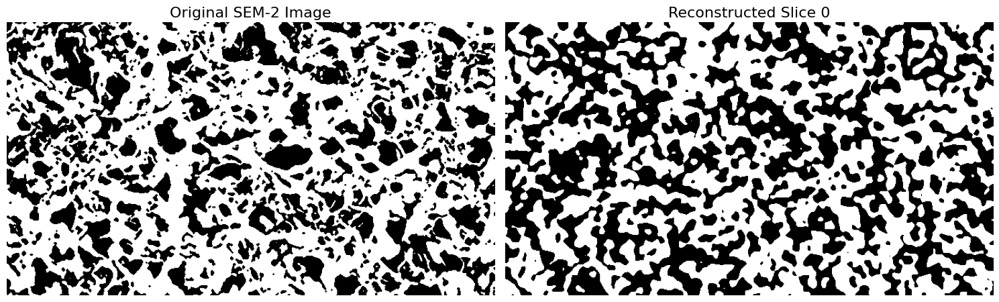

In [128]:
Fig_4b_ucb_row = result_df[
    (result_df['Acquisition Function'] == 'poi') &
    (result_df['Name'] == 'Fig_4_b')
]

wid, height = height_weight(Fig_4_b_open)
depth = 60
shape=(height,wid, depth)

Fig_4b_ucb_sigma = Fig_4a_ucb_row['Optimal_sigma'].iloc[0]
Fig_4b_ucb_quantile = Fig_4a_ucb_row['Optimal_quantile'].iloc[0]


Fig_4b_ucb_restructure = generate_synthetic_3d_structure(Fig_4a_ucb_sigma, Fig_4a_ucb_quantile,shape)
Fig_4b_ucb_reslices = extract_2d_slices(Fig_4b_ucb_restructure)

print("the Visualizing the reconstructed geometry in first six 2D slices with:",Fig_4b_ucb_sigma,Fig_4b_ucb_quantile)
num_slices_to_show = 3

fig, axes = plt.subplots(1, 2, figsize=(15, 5)) 

# First image: original image
axes[0].imshow(Fig_4_b_open, cmap='gray')
axes[0].set_title("Original SEM-2 Image", fontsize=16)
axes[0].axis('off')

# Second image: Reconstructed slice 0
axes[1].imshow(Fig_4b_ucb_reslices[0], cmap='gray')
axes[1].set_title("Reconstructed Slice 0", fontsize=16)
axes[1].axis('off')


plt.tight_layout()  
plt.show()



In [78]:
# import numpy as np
# from skimage import io 
# print(images_are_equal(check_slices_4b[0], check_slices_4b[1]))

False


### 3.4 3D visualization of reconstructed structures

### 3.4.1 3D visualization of reconstructed structures Fig 4 b

Visualization through plotly scatter method

In [24]:
# Visualization through plotly scatter method
import numpy as np
import plotly.graph_objects as go

import plotly.io as pio
pio.renderers.default = 'iframe' 


# Define the slice area
x_start, x_end = 0, 100
y_start, y_end = 0, 100
z_start, z_end = 0, 50

# Slice the data
structure4b_part = Fig_4b_ucb_restructure[x_start:x_end, y_start:y_end, z_start:z_end]

# Generate a mask for the solid part
solid4b_mask = structure4b_part == 1  # Solid Part

# Extract coordinates containing only solids
x, y, z = np.indices(structure4b_part.shape)
x = x[solid4b_mask]
y = y[solid4b_mask]
z = z[solid4b_mask]

# Create a 3D scatter plot
fig = go.Figure()

# Add 3D scattered data
fig.add_trace(go.Scatter3d(
    x=x, 
    y=y, 
    z=z, 
    mode='markers',
    marker=dict(size=2, opacity=0.8)  # Scatter point size and transparency
))

# Set the layout
fig.update_layout(
    title='3D Point Cloud of Solid Parts of reconstruction of original SEM-2(Fig_4b)',
    scene=dict(
        xaxis_title='X Axis',
        yaxis_title='Y Axis',
        zaxis_title='Z Axis'
    )
)

fig.show()


In [22]:
# Fig 4a-ucb 6.872975          0.491697
import plotly.graph_objects as go
import numpy as np

# 定义切片区域
x_start, x_end = 0, 100
y_start, y_end = 0, 100
z_start, z_end = 0, 50

wid, height = height_weight(Fig_4_b_open)
depth = 60
shape=(height,wid, depth)

         
# Fig_4b_ucb_restructure = generate_synthetic_3d_structure(6.872975 , 0.491697,shape)

# Slice the data
structure4b_part = Fig_4b_ucb_restructure[x_start:x_end, y_start:y_end, z_start:z_end]

# Generate index grid
x, y, z = np.indices(structure4b_part.shape)  # Generate a 3D index grid
x = x.flatten()  # Flatten x coordinates into a 1D array
y = y.flatten()  # Flatten y coordinates into a 1D array
z = z.flatten()  # Flatten z coordinates into a 1D array
values = structure4b_part.flatten()  # Flatten the 3D structure into a 1D array

# Create a Plotly Figure object and add a Volume object
fig = go.Figure(data=go.Volume(
    x=x,  # Set x-axis coordinates
    y=y,  # Set y-axis coordinates
    z=z,  # Set z-axis coordinates
    value=values,  # Set the values for volume rendering
    isomin=0.5,  # Set the minimum isosurface value; regions with values below 0.5 will not be displayed
    isomax=1,  # Set the maximum isosurface value; regions with values above 1 will not be displayed
    opacity=0.5,  # Set the opacity; lower opacity is needed to view all surfaces
    surface_count=10  # Set the number of surfaces; a higher count provides finer volume rendering
))

# Display the 3D volume rendering
fig.show()



In [25]:
# Reconstruction result of Fig4-b
from mayavi import mlab
import numpy as np
from traitsui.api import Editor

Editor._ui_toolkit = 'qt' 

# Assuming generate_synthetic_3d_structure is defined and works as expected
# Fig_4b_ucb_restructure = generate_synthetic_3d_structure(3.160920, 0.337461,shape = (380,680,60))


# Select a block range of interest for display to avoid image crash due to being too large to display
x_min, x_max = 0, 300
y_min, y_max = 0, 300
z_min, z_max = 0, 50


b_structure_chunk = Fig_4b_ucb_restructure[x_min:x_max, y_min:y_max, z_min:z_max]

# Volume visualization with Mayavi
mlab.figure(size=(800, 800))


mlab.pipeline.volume(mlab.pipeline.scalar_field(b_structure_chunk), vmin=0, vmax=1)

mlab.show()


# 4. Evaluation

### 2D porosity

In [40]:
import numpy as np

def calculate_2dporosity(slice_image):
    # Calculate the number of pixels with a value of 0 in a single slice (representing the pore area)
    pore_area = np.sum(slice_image == 0)
    
    # Calculate the total area of ​​the slice (total number of pixels)
    total_area = slice_image.size
    
    # Calculate and return the porosity
    porosity = pore_area / total_area * 100
    return porosity


In [41]:

def average_2dporosity(slices, num):
    # Get the total number of all slices
    len_slices = len(slices)
    
    # Randomly select the index of num slices
    random_indices = np.random.choice(len_slices, num, replace=False)
    
    # Calculate the porosity of the selected slice
    porosities = []
    for i in random_indices:
        porosity = calculate_2dporosity(slices[i])
    porosities.append(porosity)
    
    # Returns the average porosity
    return np.mean(porosities)



### 2D Specific surface area

In [42]:
# Surface area of slice
def calculate_single_surface(single_slice):
    if len(single_slice.shape) > 2:
        print("This slice is not a binary image")
        single_slice = cv2.cvtColor(single_slice, cv2.COLOR_BGR2GRAY)
     
    inverted_image = (single_slice == 0).astype(np.uint8)
    contours, hierarchy = cv2.findContours(inverted_image,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    
     # Calculate the perimeter of all contours
    total_perimeter = 0
    for contour in contours:
        perimeter = cv2.arcLength(contour, True)
        total_perimeter += perimeter
        
    # Calculate the total area of the image
    height, width = single_slice.shape
    total_area = height * width
    # Calculate the specific surface area
    specific_surface = total_perimeter / total_area
    
    return specific_surface
    

In [43]:
def calculate_num_surface(slices, num):
    # Get the total number of all slices
    len_slices = len(slices)
    
    # Randomly select the index of num slices
    random_indices = np.random.choice(len_slices, num, replace=False)
    
    # Calculate the specific surface area of ​​the selected slice
    surface_num_area = []
    for i in random_indices:
        surface_area = calculate_single_surface(slices[i])
    surface_num_area.append(surface_area)
    
    return np.mean(surface_num_area)

### Verify the validity of the results

In [84]:
# Calculate relative error
def Calculate_Evalative_Error(ori,re):
    absolute_error = abs(ori - re)
    relative_error = absolute_error/ori
    percentage_error = relative_error * 100
    return percentage_error


In [129]:
first_target_slice = results_acq[0]['Target_slice']

# first_slice = results_acq['Target_slice'][0]
wid, height = height_weight(first_target_slice)
# results_acq['Target_slice'][0]
print(wid, height)

680 380


In [130]:
# Evaluation on Synthetic Data
evaluate_results_real = []

for i,result in enumerate (results_acq):
    ori_slice = result['Target_slice']
    optimal_sigma = result['Optimal_sigma']
    optimal_quantile = result['Optimal_quantile']
    acq = result['Acquisition Function']
    
    wid, height = height_weight(target_slice)
    depth = 60
    shape=( height,wid, depth)
    
    re_structure = generate_synthetic_3d_structure(sigma=optimal_sigma, quantile=optimal_quantile,shape = shape)
    re_slices = extract_2d_slices(re_structure)
    
    ori_2dporosity = calculate_2dporosity(ori_slice)
    re_2dporosity = average_2dporosity(re_slices, num = 10)
    diff_2dporosity = abs(ori_2dporosity-re_2dporosity)
    re_error_2dporosity = Calculate_Evalative_Error(ori_2dporosity,re_2dporosity)
    
    ori_surface = calculate_single_surface(ori_slice)
    re_surface = calculate_num_surface(re_slices, num = 10)
    diff_surface = abs(ori_surface-re_surface)
    re_error_surface = Calculate_Evalative_Error(ori_surface,re_surface)
    
    evaluate_results_real.append({
        'Acquisition Function':acq,
        'Optimal Sigma':optimal_sigma,
        'Optimal Quantile':optimal_quantile,
        
        '2D Porosity Diff(10,%)':re_error_2dporosity,
        'Specific Area Diff(10,%)':re_error_surface,
    })



In [131]:
import pandas as pd
evaluate_result_df = pd.DataFrame(evaluate_results_real)
print(evaluate_result_df)
evaluate_result_df.to_csv('Real data-evaluate.csv', index=False)

   Acquisition Function  Optimal Sigma  Optimal Quantile  \
0                   ucb       3.160920          0.337461   
1                    ei       3.452423          0.376400   
2                   poi       3.270244          0.346471   
3                   ucb       4.610067          0.552696   
4                    ei       3.586038          0.409932   
5                   poi       3.230799          0.352119   
6                   ucb       6.909552          0.402575   
7                    ei       6.983441          0.398781   
8                   poi       6.986274          0.397160   
9                   ucb       6.678124          0.417992   
10                   ei       6.767225          0.421508   
11                  poi       6.252908          0.368795   

    2D Porosity Diff(10,%)  Specific Area Diff(10,%)  
0                11.283109                  4.788273  
1                 1.095992                  6.116223  
2                 8.062417                  6.005186  

In [21]:
# # Test
# re_structure = generate_synthetic_3d_structure(6.872974619357854,0.4916969366739951)
# re_slices = extract_2d_slices(re_structure)

# ori_slice = Fig_4_b_open

# ori_2dporosity = average_2dporosity(ori_slice, num = 10)
# print("ori_2dporosity:",ori_2dporosity)
# re_2dporosity = calculate_2dporosity(ori_slice)
# print("re_2dporosity:",re_2dporosity)
# diff_2dporosity = abs(ori_2dporosity-re_2dporosity)
# print("diff_2dporosity",diff_2dporosity)

ori_2dporosity: 43.62017804154303
re_2dporosity: 46.29242673224018
diff_2dporosity 2.6722486906971525
